#### <span style="color:red">**Import all required libraries and packages**</span>


In [42]:
import pandas as pd
from pathlib import Path
import re
import numpy as np
from scipy import stats
import matplotlib.pyplot as plt
import seaborn as sns
from mpl_toolkits.mplot3d import Axes3D
from sklearn.preprocessing import LabelEncoder


#### <span style="color:red">**Read dataset file and load it in a pandas dataframe**</span>


In [43]:
nasa_csv = Path('nasa.csv')

try:
    df = pd.read_csv(nasa_csv)
except FileNotFoundError:
    print(f"Error: The file {nasa_csv} was not found.")
    exit(1)
    
df

,Neo Reference ID,Name,Absolute Magnitude,Est Dia in KM(min),Est Dia in KM(max),Est Dia in M(min),Est Dia in M(max),Est Dia in Miles(min),Est Dia in Miles(max),Est Dia in Feet(min),...,Asc Node Longitude,Orbital Period,Perihelion Distance,Perihelion Arg,Aphelion Dist,Perihelion Time,Mean Anomaly,Mean Motion,Equinox,Hazardous
0,3703080,3703080,21.600,0.127220,0.284472,127.219879,284.472297,0.079051,0.176763,417.388066,...,314.373913,609.599786,0.808259,57.257470,2.005764,2.458162e+06,264.837533,0.590551,J2000,True
1,3723955,3723955,21.300,0.146068,0.326618,146.067964,326.617897,0.090762,0.202951,479.225620,...,136.717242,425.869294,0.718200,313.091975,1.497352,2.457795e+06,173.741112,0.845330,J2000,False
2,2446862,2446862,20.300,0.231502,0.517654,231.502122,517.654482,0.143849,0.321655,759.521423,...,259.475979,643.580228,0.950791,248.415038,1.966857,2.458120e+06,292.893654,0.559371,J2000,True
3,3092506,3092506,27.400,0.008801,0.019681,8.801465,19.680675,0.005469,0.012229,28.876199,...,57.173266,514.082140,0.983902,18.707701,1.527904,2.457902e+06,68.741007,0.700277,J2000,False
4,3514799,3514799,21.600,0.127220,0.284472,127.219879,284.472297,0.079051,0.176763,417.388066,...,84.629307,495.597821,0.967687,158.263596,1.483543,2.457814e+06,135.142133,0.726395,J2000,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4682,3759007,3759007,23.900,0.044112,0.098637,44.111820,98.637028,0.027410,0.061290,144.723824,...,164.183305,457.179984,0.741558,276.395697,1.581299,2.457708e+06,304.306025,0.787436,J2000,False
4683,3759295,3759295,28.200,0.006089,0.013616,6.089126,13.615700,0.003784,0.008460,19.977449,...,345.225230,407.185767,0.996434,42.111064,1.153835,2.458088e+06,282.978786,0.884117,J2000,False
4684,3759714,3759714,22.700,0.076658,0.171412,76.657557,171.411509,0.047633,0.106510,251.501180,...,37.026468,690.054279,0.965760,274.692712,2.090708,2.458300e+06,203.501147,0.521698,J2000,False
4685,3759720,3759720,21.800,0.116026,0.259442,116.025908,259.441818,0.072095,0.161210,380.662441,...,163.802910,662.048343,1.185467,180.346090,1.787733,2.458288e+06,203.524965,0.543767,J2000,False


#### <span style="color:red">**Size of the dataset**</span>


In [44]:
shape = df.shape
print(f'The dataset contains {shape[0]} rows and {shape[1]} columns.')

The dataset contains 4687 rows and 40 columns.


<span style="color:red">**Drop duplicates**</span>


In [45]:
df.drop_duplicates()
shape = df.shape
print(f'After dropping duplicates, the dataset contains {shape[0]} rows and {shape[1]} columns.')

After dropping duplicates, the dataset contains 4687 rows and 40 columns.


#### <span style="color:red">**Check if any values in the dataset is 'None'**</span>


In [46]:
print('Check for None values in the dataset:')
is_na_df = 'No \'None\' valies' if df.isna().sum().sum() == 0 else 'Has NA values'
is_na_df

Check for None values in the dataset:


"No 'None' valies"

#### <span style="color:red">**Since none of the values in the dataset are 'None', there is no need to fill 'None' values with 0 or mean**</span>


#### <span style="color:red">**Column names**</span>


In [47]:
columns = df.columns
print('Column names:')
columns

Column names:


Index(['Neo Reference ID', 'Name', 'Absolute Magnitude', 'Est Dia in KM(min)',
       'Est Dia in KM(max)', 'Est Dia in M(min)', 'Est Dia in M(max)',
       'Est Dia in Miles(min)', 'Est Dia in Miles(max)',
       'Est Dia in Feet(min)', 'Est Dia in Feet(max)', 'Close Approach Date',
       'Epoch Date Close Approach', 'Relative Velocity km per sec',
       'Relative Velocity km per hr', 'Miles per hour',
       'Miss Dist.(Astronomical)', 'Miss Dist.(lunar)',
       'Miss Dist.(kilometers)', 'Miss Dist.(miles)', 'Orbiting Body',
       'Orbit ID', 'Orbit Determination Date', 'Orbit Uncertainity',
       'Minimum Orbit Intersection', 'Jupiter Tisserand Invariant',
       'Epoch Osculation', 'Eccentricity', 'Semi Major Axis', 'Inclination',
       'Asc Node Longitude', 'Orbital Period', 'Perihelion Distance',
       'Perihelion Arg', 'Aphelion Dist', 'Perihelion Time', 'Mean Anomaly',
       'Mean Motion', 'Equinox', 'Hazardous'],
      dtype='object')

#### <span style="color:red">**Normalize column names by removing spaces, dots, paranthesis and converting into Title Case**</span>


In [48]:
df.columns = (
    df.columns
    .str.lower() 
    .str.replace('[^0-9a-zA-Z]+', '_', regex=True) 
    .str.strip('_')
    .str.title()
)
print('Normalized Column names:')
df.columns

Normalized Column names:


Index(['Neo_Reference_Id', 'Name', 'Absolute_Magnitude', 'Est_Dia_In_Km_Min',
       'Est_Dia_In_Km_Max', 'Est_Dia_In_M_Min', 'Est_Dia_In_M_Max',
       'Est_Dia_In_Miles_Min', 'Est_Dia_In_Miles_Max', 'Est_Dia_In_Feet_Min',
       'Est_Dia_In_Feet_Max', 'Close_Approach_Date',
       'Epoch_Date_Close_Approach', 'Relative_Velocity_Km_Per_Sec',
       'Relative_Velocity_Km_Per_Hr', 'Miles_Per_Hour',
       'Miss_Dist_Astronomical', 'Miss_Dist_Lunar', 'Miss_Dist_Kilometers',
       'Miss_Dist_Miles', 'Orbiting_Body', 'Orbit_Id',
       'Orbit_Determination_Date', 'Orbit_Uncertainity',
       'Minimum_Orbit_Intersection', 'Jupiter_Tisserand_Invariant',
       'Epoch_Osculation', 'Eccentricity', 'Semi_Major_Axis', 'Inclination',
       'Asc_Node_Longitude', 'Orbital_Period', 'Perihelion_Distance',
       'Perihelion_Arg', 'Aphelion_Dist', 'Perihelion_Time', 'Mean_Anomaly',
       'Mean_Motion', 'Equinox', 'Hazardous'],
      dtype='object')

#### <span style="color:red">**Reduce the number of columns that don't add information**</span>


| Column                       | Description                        | Keep/Drop | Reason                                       |
| ---------------------------- | ---------------------------------- | --------- | -------------------------------------------- |
| Neo_Reference_Id             | Unique asteroid ID                 | ❌         | Identifier only, not useful for analysis     |
| Name                         | Asteroid name                      | ❌         | Text, not needed for math/ML                 |
| Absolute_Magnitude           | Brightness of asteroid             | ✅         | Numeric, relevant for size & hazard analysis |
| Est_Dia_In_Km_Min            | Minimum estimated diameter (km)    | ✅         | Useful for size features                     |
| Est_Dia_In_Km_Max            | Maximum estimated diameter (km)    | ✅         | Useful for size features                     |
| Est_Dia_In_M_Min             | Minimum estimated diameter (m)     | ❌         | Redundant, km columns suffice                |
| Est_Dia_In_M_Max             | Maximum estimated diameter (m)     | ❌         | Redundant                                    |
| Est_Dia_In_Miles_Min         | Min diameter in miles              | ❌         | Redundant                                    |
| Est_Dia_In_Miles_Max         | Max diameter in miles              | ❌         | Redundant                                    |
| Est_Dia_In_Feet_Min          | Min diameter in feet               | ❌         | Redundant                                    |
| Est_Dia_In_Feet_Max          | Max diameter in feet               | ❌         | Redundant                                    |
| Close_Approach_Date          | Date of close approach             | ✅         | Useful for time-based analysis               |
| Epoch_Date_Close_Approach    | Epoch timestamp                    | ❌         | Redundant if you have date already           |
| Relative_Velocity_Km_Per_Sec | Speed in km/s                      | ❌         | Keep km/hr instead                           |
| Relative_Velocity_Km_Per_Hr  | Speed in km/hr                     | ✅         | Main velocity feature                        |
| Miles_Per_Hour               | Speed in mph                       | ❌         | Redundant, Keep km/hr instead                |
| Miss_Dist_Astronomical       | Distance in AU                     | ❌         | Keep km instead                              |
| Miss_Dist_Lunar              | Distance in lunar units            | ❌         | Keep km instead                              |
| Miss_Dist_Kilometers         | Distance from Earth in km          | ✅         | Important numeric feature                    |
| Miss_Dist_Miles              | Distance in miles                  | ❌         | Keep km instead                              |
| Orbiting_Body                | Planet the asteroid approached     | ❌         | All values are 'Earth'                        |
| Orbit_Id                     | Orbit ID                           | ❌         | Administrative, not needed                   |
| Orbit_Determination_Date     | Orbit determination date           | ❌         | Not needed                                   |
| Orbit_Uncertainity           | Orbit uncertainty                  | ❌         | Optional, can remove                         |
| Minimum_Orbit_Intersection   | Closest orbit intersection         | ✅         | Scientifically relevant                      |
| Jupiter_Tisserand_Invariant  | Orbital parameter                  | ✅         | Useful for analysis                          |
| Epoch_Osculation             | Orbital epoch                      | ✅         | Calculate position at any time               |
| Eccentricity                 | Orbital eccentricity               | ✅         | Numeric feature                              |
| Semi_Major_Axis              | Semi-major axis                    | ✅         | Numeric feature                              |
| Inclination                  | Orbital inclination                | ✅         | Numeric feature                              |
| Asc_Node_Longitude           | Longitude of ascending node        | ✅         | Numeric feature                              |
| Orbital_Period               | Orbital period                     | ✅         | Numeric feature                              |
| Perihelion_Distance          | Perihelion distance                | ✅         | Numeric feature                              |
| Perihelion_Arg               | Perihelion argument                | ✅         | Numeric feature                              |
| Aphelion_Dist                | Aphelion distance                  | ✅         | Numeric feature                              |
| Perihelion_Time              | Perihelion passage time            | ✅         | Numeric/time feature                         |
| Mean_Anomaly                 | Mean anomaly                       | ✅         | Numeric feature                              |
| Mean_Motion                  | Mean motion                        | ✅         | Numeric feature                              |
| Equinox                      | Reference epoch                    | ❌         | Constant = J2000 across all rows             |
| Hazardous                    | Potentially hazardous (True/False) | ✅         | Target variable for modeling                 |


#### <span style="color:red">**Keep all constant values in a variable before dropping**</span>
<span style="color:red">**In case it is needed later**</span>

In [49]:
orbiting_body = df['Orbiting_Body'].unique()
orbiting_body

array(['Earth'], dtype=object)

In [50]:
equinox = df['Equinox'].unique()
equinox

array(['J2000'], dtype=object)

#### <span style="color:red">**Dropping useless columns**</span>

In [51]:
drop_cols = [
    'Neo_Reference_Id', 'Name', 
    'Est_Dia_In_M_Min', 'Est_Dia_In_M_Max',
    'Est_Dia_In_Miles_Min', 'Est_Dia_In_Miles_Max',
    'Est_Dia_In_Feet_Min', 'Est_Dia_In_Feet_Max',
    'Epoch_Date_Close_Approach', 'Orbiting_Body',
    'Relative_Velocity_Km_Per_Sec', 'Miles_Per_Hour',
    'Miss_Dist_Astronomical', 'Miss_Dist_Lunar', 'Miss_Dist_Miles',
    'Orbit_Id', 'Orbit_Determination_Date', 'Orbit_Uncertainity',
    'Equinox'
]

df = df.drop(columns=drop_cols)
shape = df.shape
print(f'After removing columns that don\'t add information, the dataset contains {shape[0]} rows and {shape[1]} columns.')


After removing columns that don't add information, the dataset contains 4687 rows and 21 columns.


#### <span style="color:red">**Revised dataset**</span>


In [52]:
df.head()

,Absolute_Magnitude,Est_Dia_In_Km_Min,Est_Dia_In_Km_Max,Close_Approach_Date,Relative_Velocity_Km_Per_Hr,Miss_Dist_Kilometers,Minimum_Orbit_Intersection,Jupiter_Tisserand_Invariant,Epoch_Osculation,Eccentricity,...,Inclination,Asc_Node_Longitude,Orbital_Period,Perihelion_Distance,Perihelion_Arg,Aphelion_Dist,Perihelion_Time,Mean_Anomaly,Mean_Motion,Hazardous
0,21.6,0.127220,0.284472,1995-01-01,22017.003799,62753692.0,0.025282,4.634,2458000.5,0.425549,...,6.025981,314.373913,609.599786,0.808259,57.257470,2.005764,2.458162e+06,264.837533,0.590551,True
1,21.3,0.146068,0.326618,1995-01-01,65210.346095,57298148.0,0.186935,5.457,2458000.5,0.351674,...,28.412996,136.717242,425.869294,0.718200,313.091975,1.497352,2.457795e+06,173.741112,0.845330,False
2,20.3,0.231502,0.517654,1995-01-08,27326.560182,7622911.5,0.043058,4.557,2458000.5,0.348248,...,4.237961,259.475979,643.580228,0.950791,248.415038,1.966857,2.458120e+06,292.893654,0.559371,True
3,27.4,0.008801,0.019681,1995-01-15,40225.948191,42683616.0,0.005512,5.093,2458000.5,0.216578,...,7.905894,57.173266,514.082140,0.983902,18.707701,1.527904,2.457902e+06,68.741007,0.700277,False
4,21.6,0.127220,0.284472,1995-01-15,35426.991794,61010824.0,0.034798,5.154,2458000.5,0.210448,...,16.793382,84.629307,495.597821,0.967687,158.263596,1.483543,2.457814e+06,135.142133,0.726395,True


#### <span style="color:red">**Columns remaining**</span>


In [53]:
df.columns

Index(['Absolute_Magnitude', 'Est_Dia_In_Km_Min', 'Est_Dia_In_Km_Max',
       'Close_Approach_Date', 'Relative_Velocity_Km_Per_Hr',
       'Miss_Dist_Kilometers', 'Minimum_Orbit_Intersection',
       'Jupiter_Tisserand_Invariant', 'Epoch_Osculation', 'Eccentricity',
       'Semi_Major_Axis', 'Inclination', 'Asc_Node_Longitude',
       'Orbital_Period', 'Perihelion_Distance', 'Perihelion_Arg',
       'Aphelion_Dist', 'Perihelion_Time', 'Mean_Anomaly', 'Mean_Motion',
       'Hazardous'],
      dtype='object')

<span style="color:red">**Down half the original dataset, leaving us with the half that is useful**</span>


In [54]:
df.head()

,Absolute_Magnitude,Est_Dia_In_Km_Min,Est_Dia_In_Km_Max,Close_Approach_Date,Relative_Velocity_Km_Per_Hr,Miss_Dist_Kilometers,Minimum_Orbit_Intersection,Jupiter_Tisserand_Invariant,Epoch_Osculation,Eccentricity,...,Inclination,Asc_Node_Longitude,Orbital_Period,Perihelion_Distance,Perihelion_Arg,Aphelion_Dist,Perihelion_Time,Mean_Anomaly,Mean_Motion,Hazardous
0,21.6,0.127220,0.284472,1995-01-01,22017.003799,62753692.0,0.025282,4.634,2458000.5,0.425549,...,6.025981,314.373913,609.599786,0.808259,57.257470,2.005764,2.458162e+06,264.837533,0.590551,True
1,21.3,0.146068,0.326618,1995-01-01,65210.346095,57298148.0,0.186935,5.457,2458000.5,0.351674,...,28.412996,136.717242,425.869294,0.718200,313.091975,1.497352,2.457795e+06,173.741112,0.845330,False
2,20.3,0.231502,0.517654,1995-01-08,27326.560182,7622911.5,0.043058,4.557,2458000.5,0.348248,...,4.237961,259.475979,643.580228,0.950791,248.415038,1.966857,2.458120e+06,292.893654,0.559371,True
3,27.4,0.008801,0.019681,1995-01-15,40225.948191,42683616.0,0.005512,5.093,2458000.5,0.216578,...,7.905894,57.173266,514.082140,0.983902,18.707701,1.527904,2.457902e+06,68.741007,0.700277,False
4,21.6,0.127220,0.284472,1995-01-15,35426.991794,61010824.0,0.034798,5.154,2458000.5,0.210448,...,16.793382,84.629307,495.597821,0.967687,158.263596,1.483543,2.457814e+06,135.142133,0.726395,True



#### <span style="color:red">**Remove outliers using z-score**</span>
<span style="color:red">**Make sure correct numeric columns have thier outliers removed: removing outliers from epoch timestamps is useless**</span>




In [55]:
numeric_cols = ['Absolute_Magnitude', 'Est_Dia_In_Km_Min', 'Est_Dia_In_Km_Max', 
                'Relative_Velocity_Km_Per_Hr', 'Miss_Dist_Kilometers', 
                'Minimum_Orbit_Intersection', 'Jupiter_Tisserand_Invariant',
                'Eccentricity', 'Semi_Major_Axis', 'Inclination', 'Asc_Node_Longitude',
                'Orbital_Period', 'Perihelion_Distance', 'Perihelion_Arg',
                'Aphelion_Dist', 'Perihelion_Time', 'Mean_Anomaly', 'Mean_Motion']

z_scores = np.abs(stats.zscore(df[numeric_cols]))

df = df[(z_scores < 3).all(axis=1)]

print(f"New dataset size: {df.shape[0]} rows, {df.shape[1]} columns")


New dataset size: 4258 rows, 21 columns


#### <span style="color:red">**Convert non-numeric columns to numeric by encoding**</span>


<span style="color:red">**Hazardous can either be true of false -> 1 or 0**</span>


In [56]:
# Binary encoding 
# 1 = True (Hazardous)
# 0 = False (Not Hazardous)
df['Hazardous'] = df['Hazardous'].astype(int)
df['Hazardous'].head()

0    1
1    0
2    1
3    0
4    1
Name: Hazardous, dtype: int64

#### <span style="color:red">**EDA analysis**</span>

<span style="color:red">**Distribution of Hazardous and Non-Hazardous Asteroids**</span>


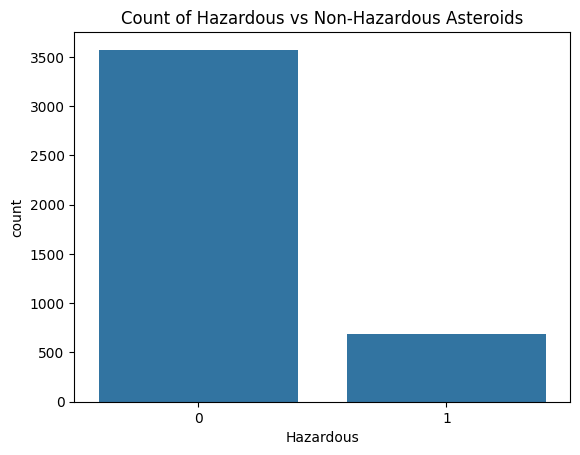

In [69]:
sns.countplot(x='Hazardous', data=df)
plt.title('Count of Hazardous vs Non-Hazardous Asteroids')
plt.show()

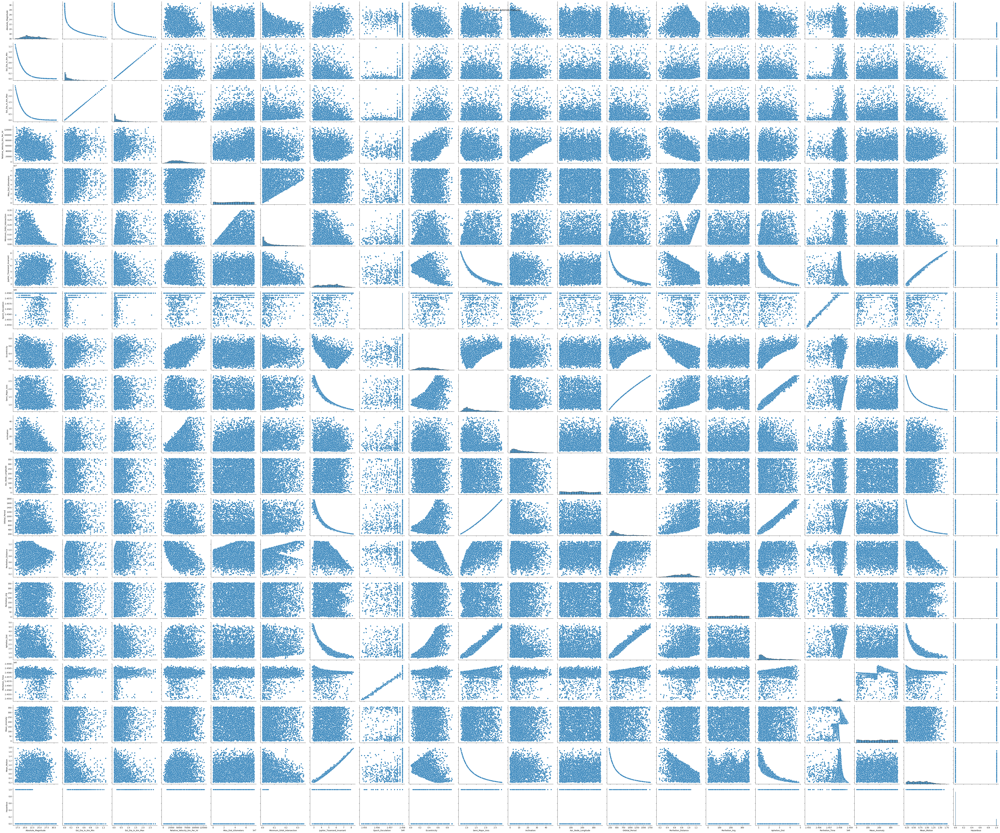

In [71]:
sns.pairplot(df, height=3, aspect=1.2)
plt.suptitle('Pairplot of NASA Asteroid Features')
plt.show()

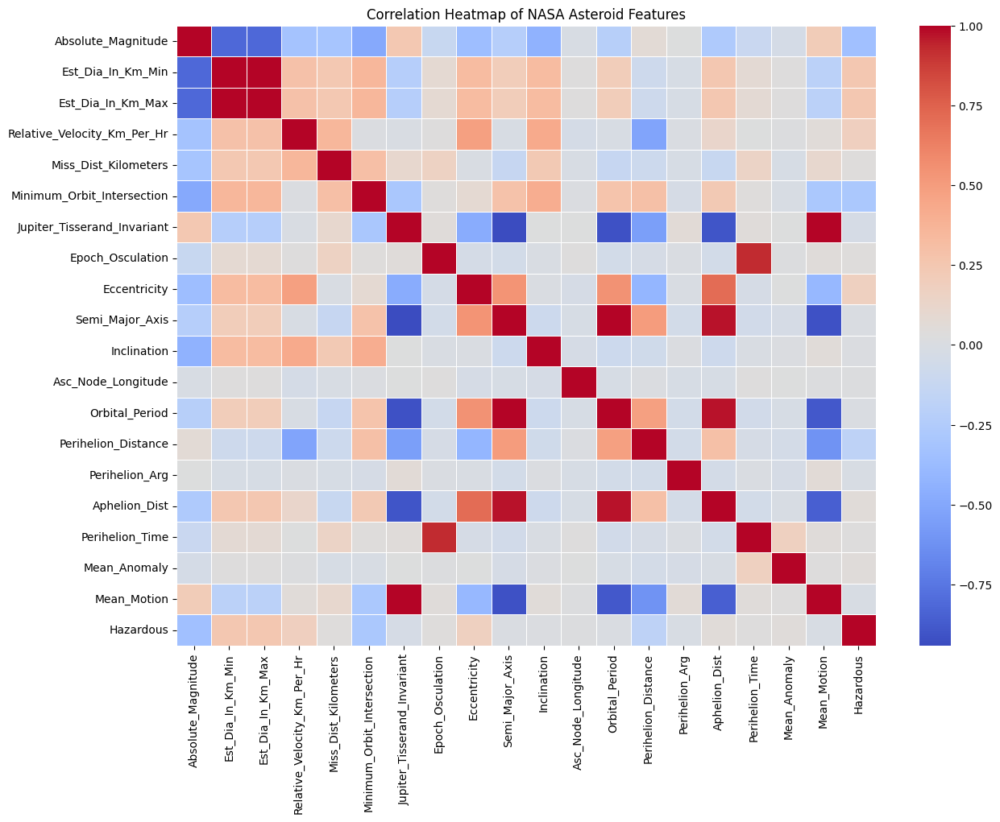

In [68]:
corr = df.corr(numeric_only=True)
plt.figure(figsize=(14, 10))
sns.heatmap(corr, annot=False, cmap='coolwarm', linewidths=0.5)
plt.title("Correlation Heatmap of NASA Asteroid Features")
plt.show()


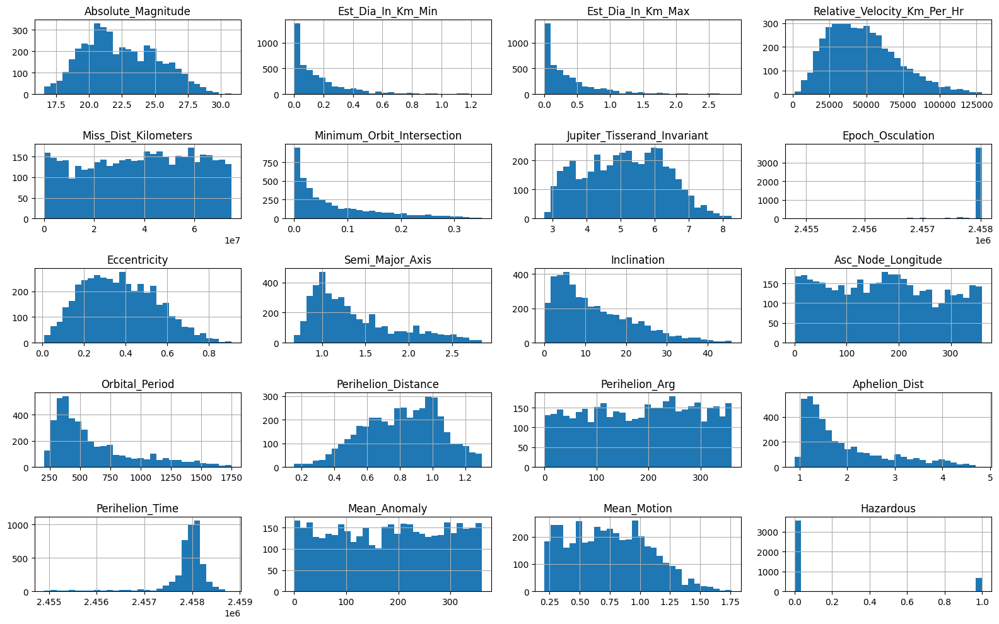

In [74]:
numeric_cols = df.select_dtypes(include=['float64', 'int64']).columns

df[numeric_cols].hist(figsize=(16, 10), bins=30)
plt.tight_layout()
plt.show()


In [72]:
corr_pairs = corr.unstack().sort_values(ascending=False)
corr_pairs[(corr_pairs < 1) & (corr_pairs > 0.8)].head(10)


Est_Dia_In_Km_Max            Est_Dia_In_Km_Min              1.000000
Est_Dia_In_Km_Min            Est_Dia_In_Km_Max              1.000000
Semi_Major_Axis              Orbital_Period                 0.996737
Orbital_Period               Semi_Major_Axis                0.996737
Mean_Motion                  Jupiter_Tisserand_Invariant    0.994069
Jupiter_Tisserand_Invariant  Mean_Motion                    0.994069
Aphelion_Dist                Orbital_Period                 0.977212
Orbital_Period               Aphelion_Dist                  0.977212
Aphelion_Dist                Semi_Major_Axis                0.973693
Semi_Major_Axis              Aphelion_Dist                  0.973693
dtype: float64